# <center> EDA AND CLASSIFICATION IN ASTRONOMY

# 1. Configuring the Environment

## Importing required libraries

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm.notebook import tqdm_notebook
import timeit
from sklearn.preprocessing import LabelEncoder
from sklearn.feature_selection import chi2, mutual_info_classif, SelectKBest, f_classif
from sklearn.ensemble import RandomForestClassifier, ExtraTreesClassifier, GradientBoostingClassifier

import warnings
warnings.filterwarnings('ignore')

#!pip install plotly
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot

# 2. Data Preparation

## 2.1 Loading the data

In [2]:
%%time
df = pd.read_csv('1_lakh_entries.csv', skiprows = 0)
df

CPU times: user 279 ms, sys: 95.1 ms, total: 374 ms
Wall time: 529 ms


,objid,ra,dec,u,g,r,i,z,run,rerun,camcol,field,specobjid,class,redshift,plate,mjd,fiberid
0,1.237650e+18,210.016478,3.924162,19.58006,17.70593,16.74910,16.33185,15.97441,2190,301,2,187,9.637900e+17,GALAXY,0.075129,856,52339,71
1,1.237660e+18,137.468475,43.878875,19.29924,18.14330,17.71518,17.47768,17.43733,2777,301,3,207,9.368170e+17,GALAXY,0.093499,832,52312,249
2,1.237650e+18,14.123114,15.142815,19.28338,17.53712,16.72810,16.32265,16.04339,1904,301,4,242,4.740990e+17,GALAXY,0.078770,421,51821,346
3,1.237670e+18,266.621865,26.717041,18.74441,17.24021,16.67171,16.48060,16.37055,4828,301,6,116,2.457960e+18,STAR,-0.000124,2183,53536,445
4,1.237670e+18,159.771218,22.902207,18.18608,18.04931,17.75193,17.73256,17.78253,5137,301,4,308,7.235190e+18,QSO,1.088803,6426,56334,562
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99995,1.237650e+18,235.711610,0.032597,19.58198,17.75248,16.82558,16.40437,16.04969,752,301,4,616,3.546800e+17,GALAXY,0.082767,315,51663,80
99996,1.237650e+18,237.082722,0.185409,19.38675,17.96262,17.14279,16.68619,16.36536,752,301,4,625,3.851970e+17,GALAXY,0.113793,342,51691,506
99997,1.237650e+18,240.853253,0.092452,19.18663,17.25995,16.27921,15.79979,15.42603,752,301,4,650,3.874260e+17,GALAXY,0.054825,344,51693,424
99998,1.237650e+18,241.534281,0.013727,19.00692,16.97655,15.93292,15.45320,15.01987,752,301,4,654,3.885430e+17,GALAXY,0.057930,345,51690,392


## 2.2 Dataset Overview

The table results from an SQL query which joins two tables:

"PhotoObj" which contains photometric data.   
"SpecObj" which contains spectral data.  
16 variables (double) and 1 additional variable (char) 'class'.   
A class object can be predicted from the other 16 variables.

### Variables description:

**objid** = Object Identifier 
**ra** = J2000 Right Ascension (r-band)  
**dec** = J2000 Declination (r-band)  
**u** = better of deV/Exp magnitude fit (u-band)  
**g** = better of deV/Exp magnitude fit (g-band)  
**r** = better of deV/Exp magnitude fit (r-band)  
**i** = better of deV/Exp magnitude fit (i-band)  
**z** = better of deV/Exp magnitude fit (z-band)  
**run** = Run Number  
**rerun** = Rerun Number  
**camcol** = Camera column  
**field** = Field number  
**specobjid** = Object Identifier  
**class** = object class (galaxy, star or quasar object)  
**redshift** = Final Redshift  
**plate** = plate number  
**mjd** = MJD(Modified Julian Date) of observation  
**fiberid** = fiberID  

## 2.3 Basic information

In [3]:
df.shape

(100000, 18)

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 18 columns):
 #   Column     Non-Null Count   Dtype  
---  ------     --------------   -----  
 0   objid      100000 non-null  float64
 1   ra         100000 non-null  float64
 2   dec        100000 non-null  float64
 3   u          100000 non-null  float64
 4   g          100000 non-null  float64
 5   r          100000 non-null  float64
 6   i          100000 non-null  float64
 7   z          100000 non-null  float64
 8   run        100000 non-null  int64  
 9   rerun      100000 non-null  int64  
 10  camcol     100000 non-null  int64  
 11  field      100000 non-null  int64  
 12  specobjid  100000 non-null  float64
 13  class      100000 non-null  object 
 14  redshift   100000 non-null  float64
 15  plate      100000 non-null  int64  
 16  mjd        100000 non-null  int64  
 17  fiberid    100000 non-null  int64  
dtypes: float64(10), int64(7), object(1)
memory usage: 13.7+ MB


## Obervations

1. There are 100000 data points and 17 features.
2. There is only one categorical column.

## Dropping Features that are not significant

'objid' and 'specobjid' are only identifiers for getting to the rows back when they were put away in the original databank. Along these lines we won't need them for classification as they are not identified with the result.

Significantly more: The features 'run', 'rerun', 'camcol' and 'field' are values which describe portions of the camera right when mentioning the objective fact, for example 'run' speaks to the comparing check which caught the oject.

We'll drop these features.

In [3]:
df.drop(['run', 'rerun', 'camcol', 'field', 'objid', 'specobjid', 'fiberid'], axis = 1, inplace= True)
df.head(5)

,ra,dec,u,g,r,i,z,class,redshift,plate,mjd
0,210.016478,3.924162,19.58006,17.70593,16.74910,16.33185,15.97441,GALAXY,0.075129,856,52339
1,137.468475,43.878875,19.29924,18.14330,17.71518,17.47768,17.43733,GALAXY,0.093499,832,52312
2,14.123114,15.142815,19.28338,17.53712,16.72810,16.32265,16.04339,GALAXY,0.078770,421,51821
3,266.621865,26.717041,18.74441,17.24021,16.67171,16.48060,16.37055,STAR,-0.000124,2183,53536
4,159.771218,22.902207,18.18608,18.04931,17.75193,17.73256,17.78253,QSO,1.088803,6426,56334


# 3. High Level Statistics

## 3.1 Describing the Data

In [5]:
df.describe()

,ra,dec,u,g,r,i,z,redshift,plate,mjd
count,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000
mean,177.517993,25.048529,18.637645,17.407114,16.881728,16.625299,16.466702,0.171041,2597.153180,53918.746860
std,78.062282,20.544956,0.832263,0.985319,1.132708,1.207941,1.280648,0.439244,2225.962745,1553.442988
min,0.011306,-19.495456,10.611810,9.668339,9.005167,8.848403,8.947795,-0.004268,266.000000,51608.000000
25%,136.418824,6.732728,18.211495,16.852083,16.196345,15.864370,15.619682,0.000001,1186.000000,52734.000000
50%,180.391592,23.962150,18.874240,17.515725,16.890090,16.598420,16.427275,0.045948,2087.000000,53726.000000
75%,224.650548,40.344539,19.273580,18.056393,17.585740,17.345235,17.235225,0.095516,2911.000000,54589.000000
max,359.999615,84.490494,19.599990,19.996050,31.990100,32.141470,29.383740,7.011245,12547.000000,58932.000000


From the above table we can tell that are no missing values at all. This means: no imputing.

In [6]:
df.shape

(100000, 11)

Now we have only 10 features and 100000 data points since 6 features which were not significant to the class label were dropped.

## 3.2 Find the duplicates

In [7]:
df.duplicated().sum()

0

### Observations

There are no duplicates

## 3.4 Unique Values

In [9]:
# We can find the number of unique values in the particular column using unique() function in python.
df['class'].unique()

array(['GALAXY', 'STAR', 'QSO'], dtype=object)

In [10]:
df['class'].value_counts()

GALAXY    51304
STAR      38091
QSO       10605
Name: class, dtype: int64

## 3.4 Visualizing the Unique counts

<AxesSubplot:xlabel='class', ylabel='count'>

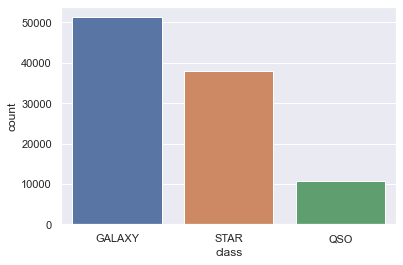

In [11]:
sns.set_theme(style="darkgrid")
sns.countplot(df['class'])

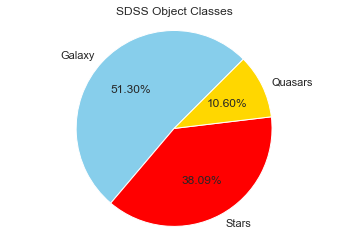

In [12]:
def pieChart(df):
    '''Plot a pie chart for label count.'''
    label_counts = df['class'].value_counts()
    colors = ['skyblue', 'red', 'gold']
    fig1, ax1 = plt.subplots()
    ax1.pie(label_counts, labels=['Galaxy', 'Stars', 'Quasars'],
            autopct='%1.2f%%', startangle=45, colors=colors)
    ax1.axis('equal')
    plt.title('SDSS Object Classes')
    plt.show()
pieChart(df)

## 3.4 Observations

1. The column 'class' is the target variable and its a categorical variable. The unique values of the class label are 'GALAXY',    'QSO' and 'STAR'
2. The dataset is quite imbalanced with number of galaxies dominating.

## 3.5 Find null values

In [13]:
df.isnull().sum()

ra          0
dec         0
u           0
g           0
r           0
i           0
z           0
class       0
redshift    0
plate       0
mjd         0
dtype: int64

There are no null values.

# 4. Univariate Analysis

Distribution plots are used to visually assess how the data points are distributed with respect to its frequency. Usually the data points are grouped into bins and the height of the bars representing each group increases with increase in the number of data points lie within that group. (histogram)

Probability Density Function (PDF) is the probability that the variable takes a value x. (smoothed version of the histogram)

## 4.1 Boxplot

In [14]:
df.columns

Index(['ra', 'dec', 'u', 'g', 'r', 'i', 'z', 'class', 'redshift', 'plate',
       'mjd'],
      dtype='object')

<AxesSubplot:xlabel='class', ylabel='mjd'>

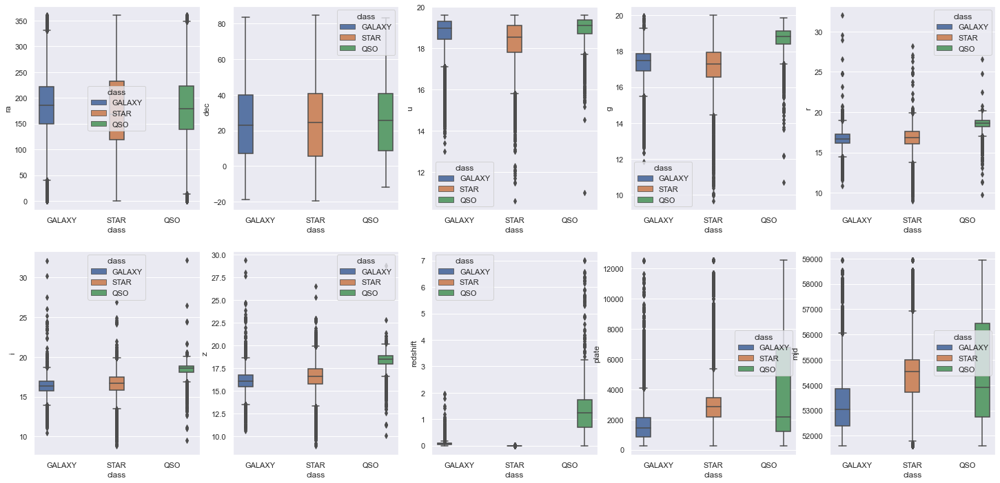

In [15]:
fig, ((ax1, ax2, ax3, ax4, ax5), (ax6, ax7, ax8, ax9, ax10)) = plt.subplots(nrows = 2, ncols = 5,
                                                                      figsize = (25,12))


sns.boxplot(ax = ax1, x = 'class', y = 'ra', hue = 'class', data = df)
sns.boxplot(ax = ax2, x = 'class', y = 'dec', hue = 'class', data = df)
sns.boxplot(ax = ax3, x = 'class', y = 'u', hue = 'class', data = df)
sns.boxplot(ax = ax4, x = 'class', y = 'g', hue = 'class', data = df)
sns.boxplot(ax = ax5, x = 'class', y = 'r', hue = 'class', data = df)
sns.boxplot(ax = ax6, x = 'class', y = 'i', hue = 'class', data = df)
sns.boxplot(ax = ax7, x = 'class', y = 'z', hue = 'class', data = df)
sns.boxplot(ax = ax8, x = 'class', y = 'redshift', hue = 'class', data = df)
sns.boxplot(ax = ax9, x = 'class', y = 'plate', hue = 'class', data = df)
sns.boxplot(ax = ax10, x = 'class', y = 'mjd', hue = 'class', data = df)

### Observations
As we can see from the boxplot there are a large number of outliers. 

## 4.2 Frequency polygon

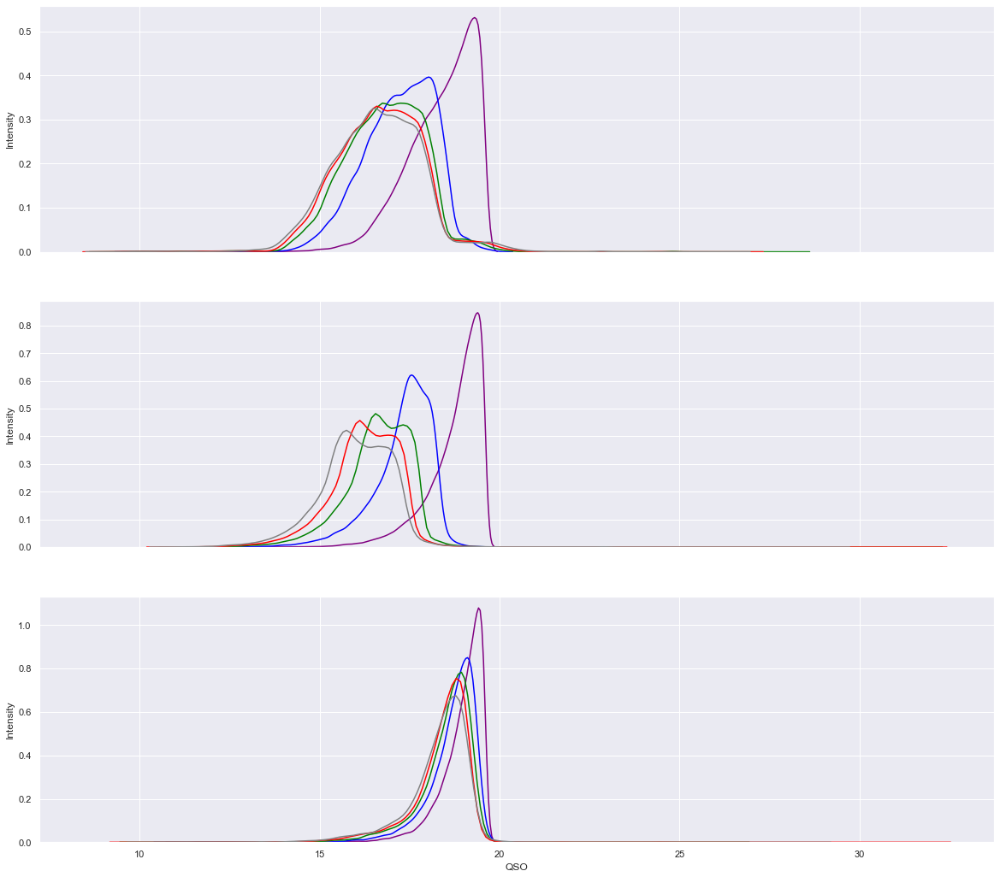

In [16]:
f, axes = plt.subplots(3, 1, figsize=(20, 18), sharex=True)
c = ['STAR', 'GALAXY', 'QSO']

for ax_id in range(3):
    sns.distplot(df.loc[df['class']==c[ax_id],'u'], hist=False, color='purple', ax=axes[ax_id], label='u')
    sns.distplot(df.loc[df['class']==c[ax_id],'g'], hist=False, color='blue', ax=axes[ax_id], label='g')
    sns.distplot(df.loc[df['class']==c[ax_id],'r'], hist=False, color='green', ax=axes[ax_id], label='r')
    sns.distplot(df.loc[df['class']==c[ax_id],'i'], hist=False, color='red', ax=axes[ax_id], label='i')
    sns.distplot(df.loc[df['class']==c[ax_id],'z'], hist=False, color='grey', ax=axes[ax_id], label='z')
    axes[ax_id].set(xlabel=c[ax_id], ylabel='Intensity')

## 4.3 Histplot

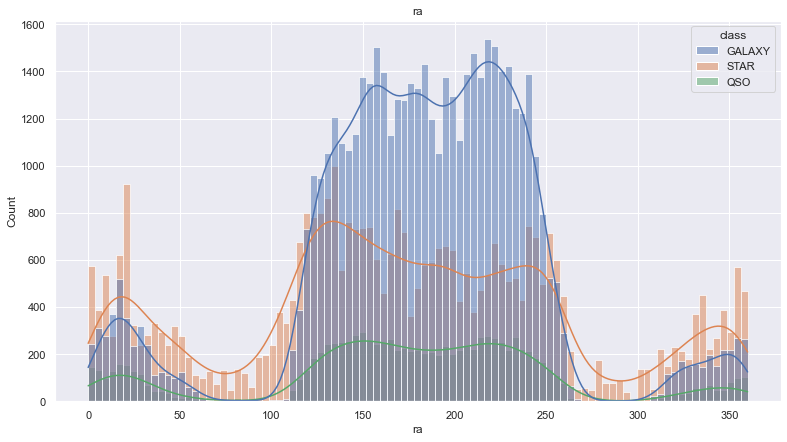

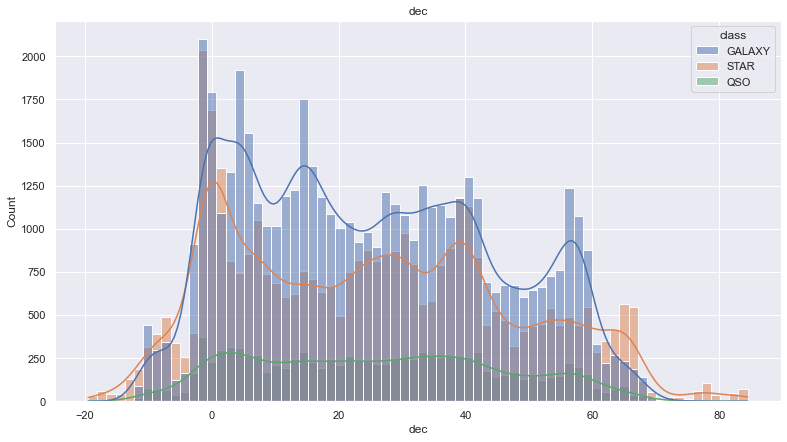

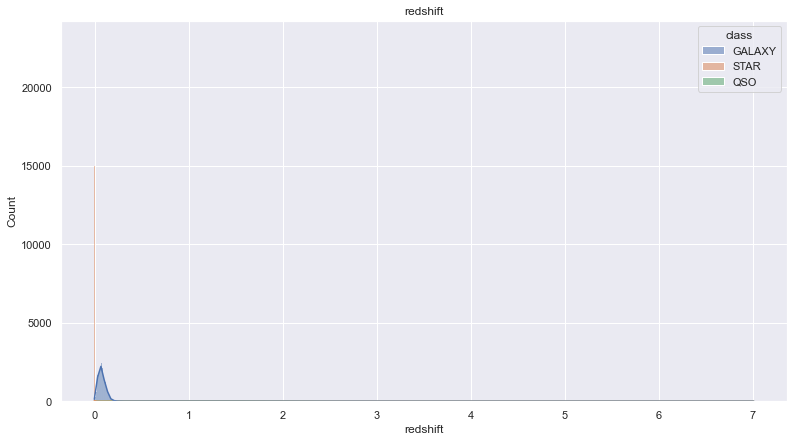

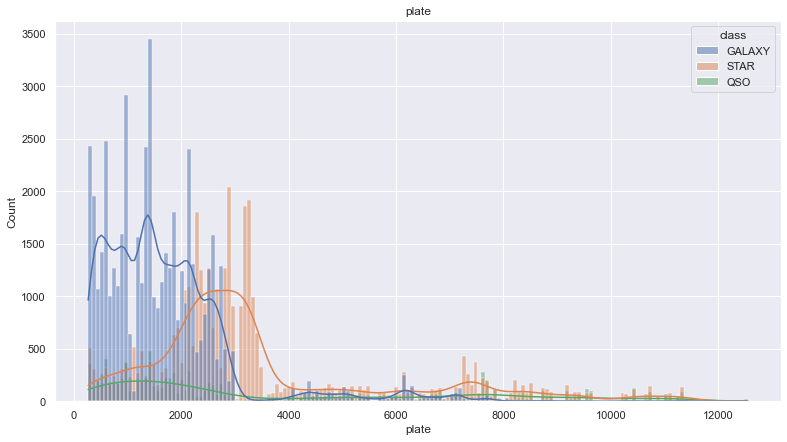

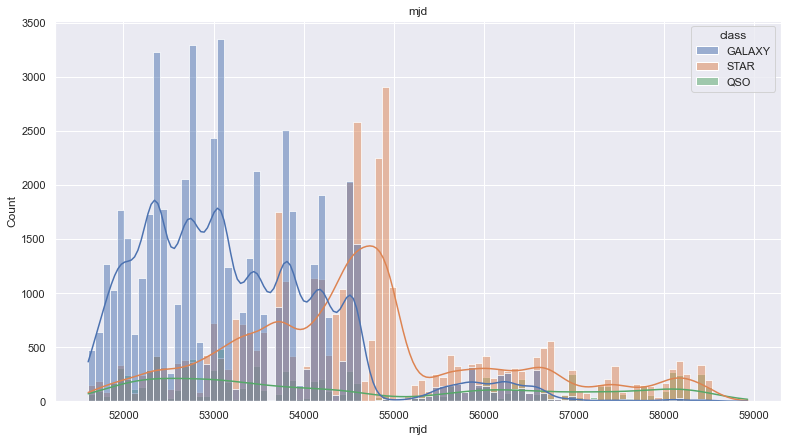

In [17]:
import seaborn as sb
for i in ['ra', 'dec', 'redshift', 'plate', 'mjd']:
    plt.figure(figsize=(13,7))
    sb.histplot(data=df, x=i, kde=True, hue="class")
    plt.title(i)
    plt.show()

## 4.4  Probability Density Function (PDF)

In [18]:
df.columns

Index(['ra', 'dec', 'u', 'g', 'r', 'i', 'z', 'class', 'redshift', 'plate',
       'mjd'],
      dtype='object')

In [19]:
col = list(df.columns)
col.pop(7)
col

['ra', 'dec', 'u', 'g', 'r', 'i', 'z', 'redshift', 'plate', 'mjd']

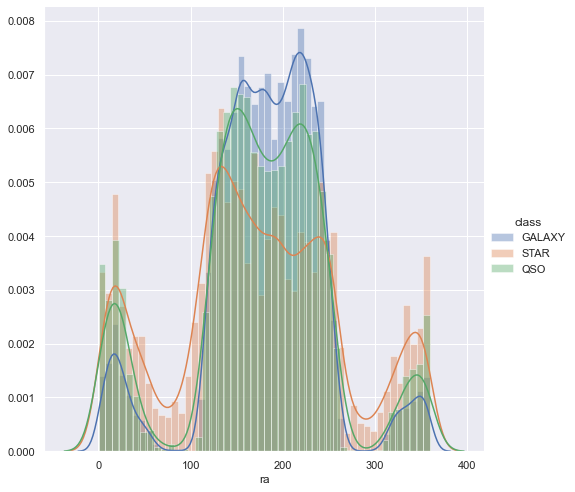

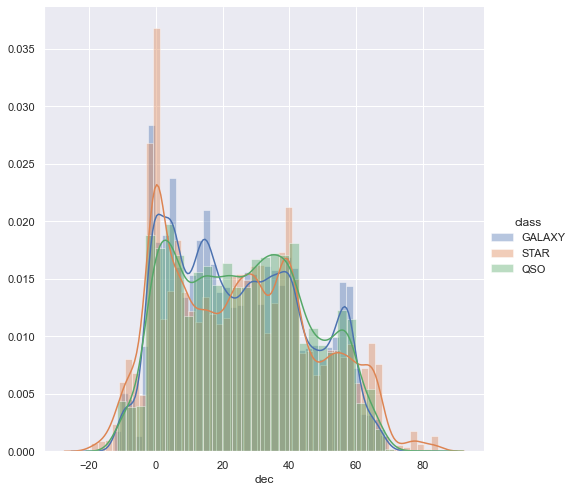

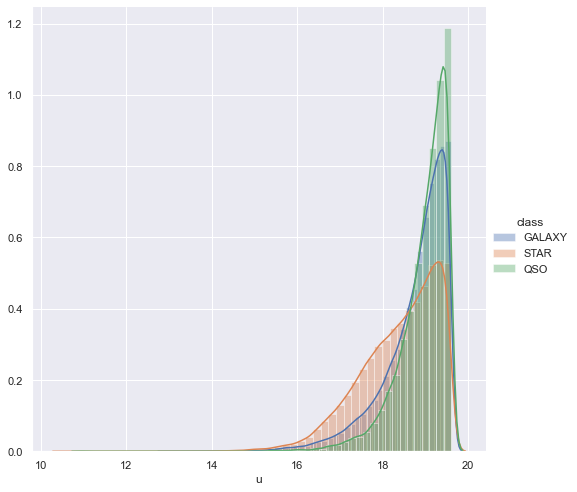

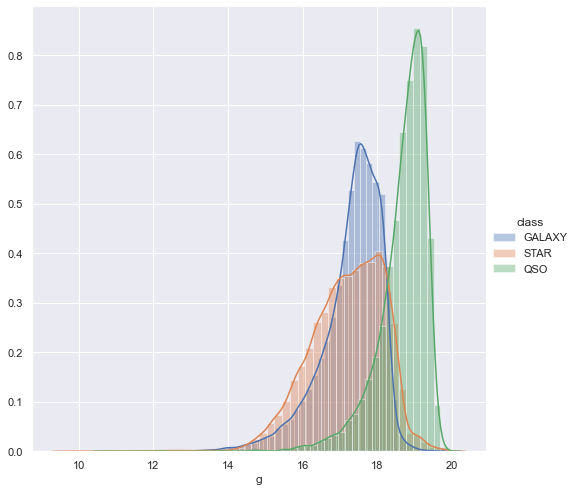

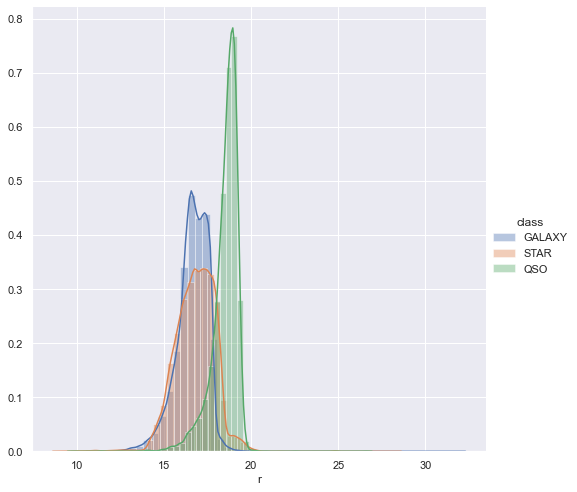

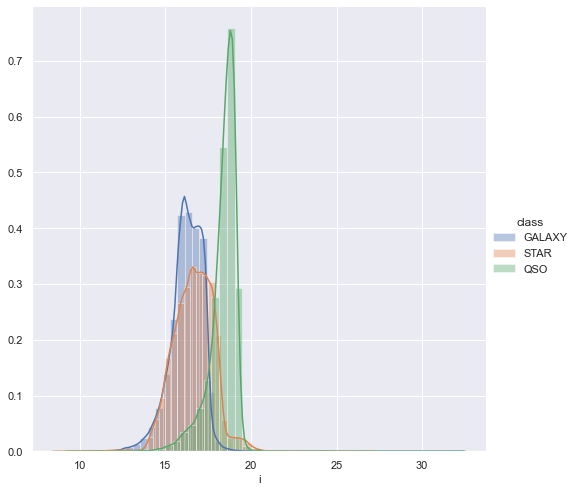

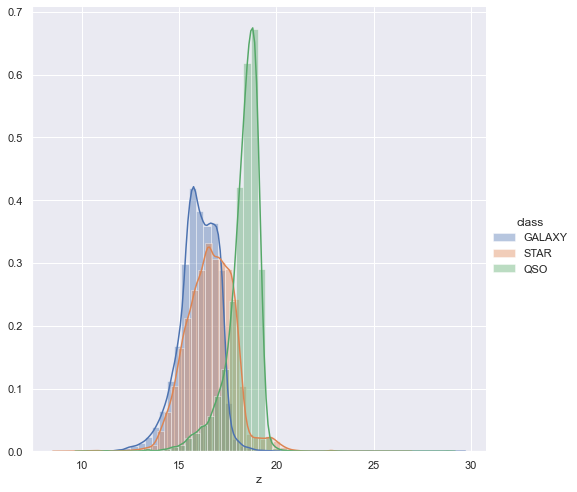

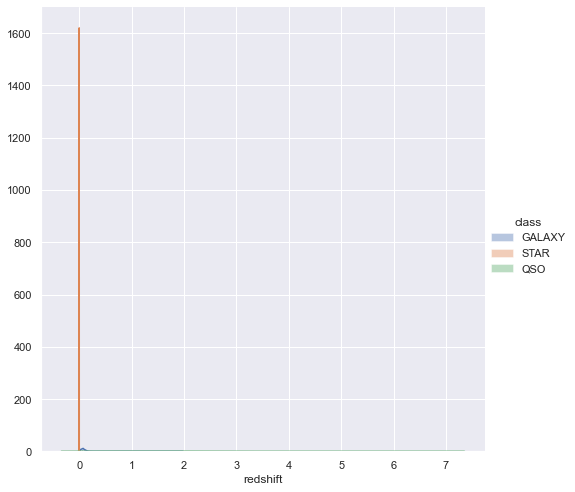

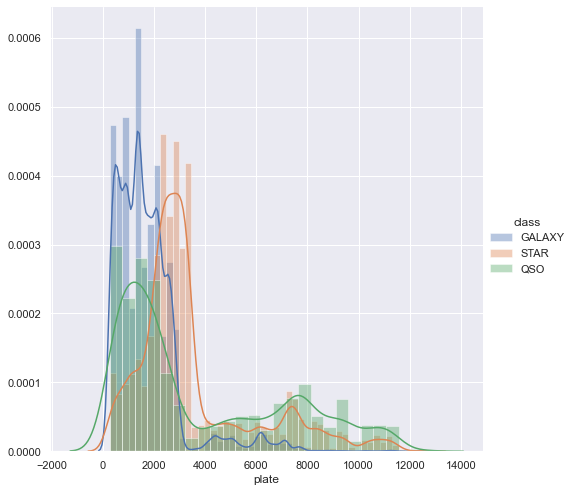

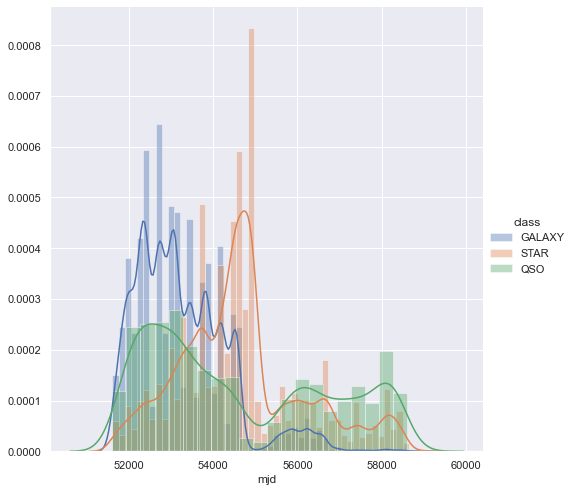

Wall time: 34.7 s


In [20]:
%%time
for idx, feature in enumerate(col):
    fg = sns.FacetGrid(df, hue='class', height=7)
    fg.map(sns.distplot, feature).add_legend()
    plt.show()

## 4.5 Violinplot

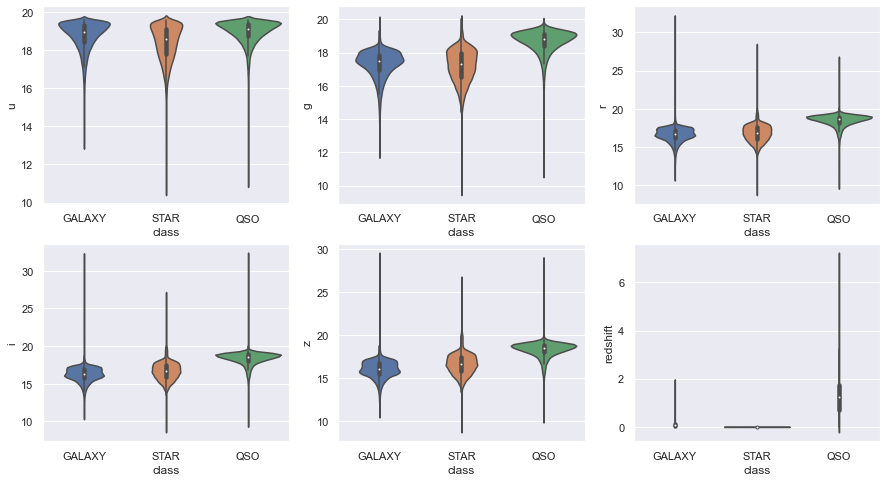

In [21]:
fig, axs = plt.subplots(2, 3, figsize=(15, 8))

sns.violinplot(x="class", y="u", data=df, ax=axs[0, 0])
sns.violinplot(x="class", y="g", data=df, ax=axs[0, 1])
sns.violinplot(x="class", y="r", data=df, ax=axs[0, 2])
sns.violinplot(x="class", y="i", data=df, ax=axs[1, 0])
sns.violinplot(x="class", y="z", data=df, ax=axs[1, 1])
sns.violinplot(x="class", y="redshift", data=df, ax=axs[1, 2])
plt.show()


## 4.6 KDE Plot

Plot univariate or bivariate distributions using kernel density estimation. A kernel density estimate (KDE) plot is a method for visualizing the distribution of observations in a dataset, analagous to a histogram. KDE represents the data using a continuous probability density curve in one or more dimensions.

A histogram puts all samples between the boundaries of each bin will fall into the bin. It doesn't differentiate whether the value falls close the left, to the right or the center of the bin. A kde plot, on the other hand, takes each individual sample value and draws a small gaussian bell curve over it.

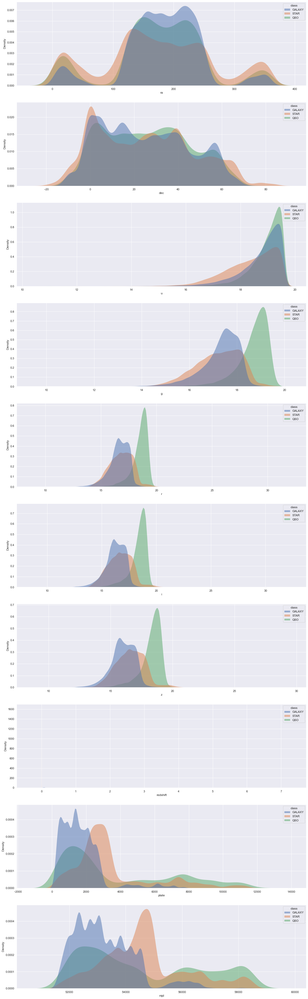

In [22]:
fig, axes = plt.subplots(nrows=10, ncols=1,figsize=(20, 70))
ax = sns.kdeplot(data=df, x='ra', hue="class", fill=True, common_norm=False, alpha=.5, linewidth=0,ax = axes[0])
ax = sns.kdeplot(data=df, x='dec', hue="class", fill=True, common_norm=False, alpha=.5, linewidth=0,ax = axes[1])
ax = sns.kdeplot(data=df, x='u', hue="class", fill=True, common_norm=False, alpha=.5, linewidth=0,ax = axes[2])
ax = sns.kdeplot(data=df, x='g', hue="class", fill=True, common_norm=False, alpha=.5, linewidth=0,ax = axes[3])
ax = sns.kdeplot(data=df, x='r', hue="class", fill=True, common_norm=False, alpha=.5, linewidth=0,ax = axes[4])
ax = sns.kdeplot(data=df, x='i', hue="class", fill=True, common_norm=False, alpha=.5, linewidth=0,ax = axes[5])
ax = sns.kdeplot(data=df, x='z', hue="class", fill=True, common_norm=False, alpha=.5, linewidth=0,ax = axes[6])
ax = sns.kdeplot(data=df, x='redshift', hue="class", fill=True, common_norm=False, alpha=.5, linewidth=0,ax = axes[7])
ax = sns.kdeplot(data=df, x='plate', hue="class", fill=True, common_norm=False, alpha=.5, linewidth=0,ax = axes[8])
ax = sns.kdeplot(data=df, x='mjd', hue="class", fill=True, common_norm=False, alpha=.5, linewidth=0,ax = axes[9])


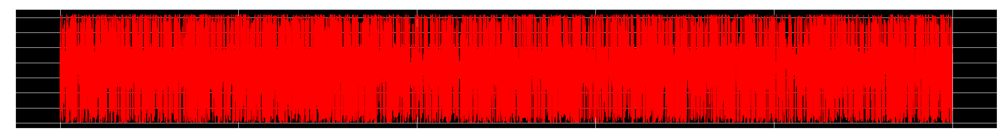

In [23]:
plt.figure(figsize = (40,5))
plt.style.use('dark_background')
plt.plot(df['ra'],color = 'red');
plt.title('ra distribution');

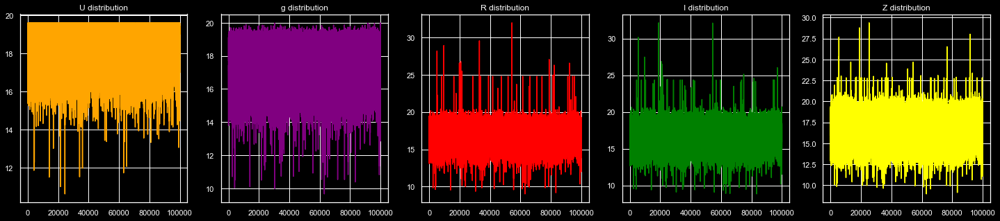

In [24]:
fig,ax = plt.subplots(1,5,figsize = (25,5))
ax[0].plot(df['u'],color = 'orange');
ax[0].set_title('U distribution');
ax[1].plot(df['g'],color = 'purple');
ax[1].set_title('g distribution');
ax[2].plot(df['r'],color = 'red');
ax[2].set_title('R distribution');
ax[3].plot(df['i'],color = 'green');
ax[3].set_title('I distribution');
ax[4].plot(df['z'],color = 'yellow');
ax[4].set_title('Z distribution');

## 5 . Multivariate Analysis

## 5.1 Lineplot

Wall time: 48.4 s


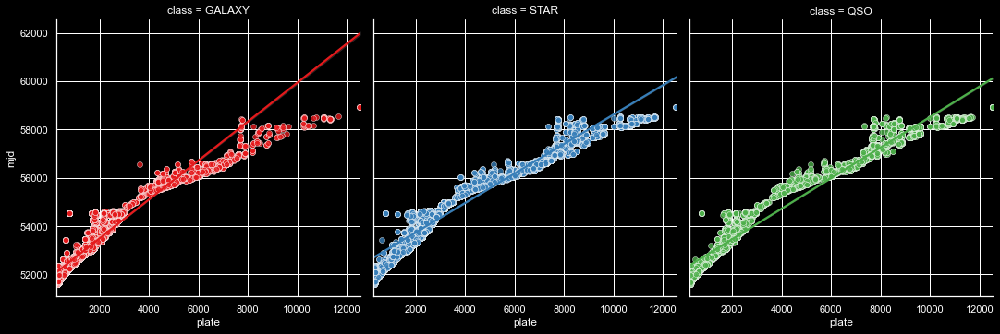

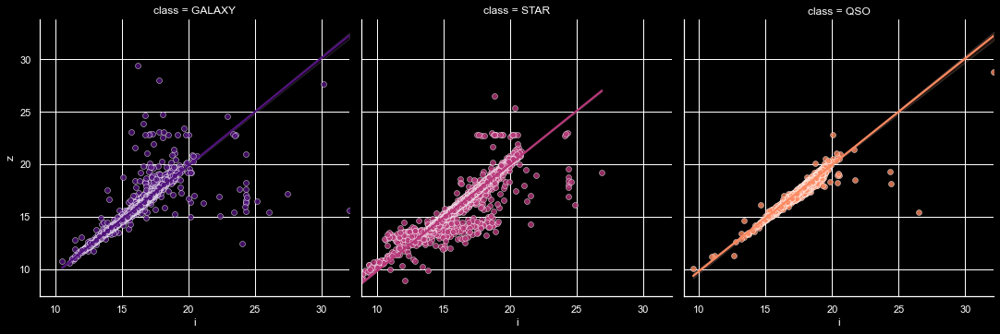

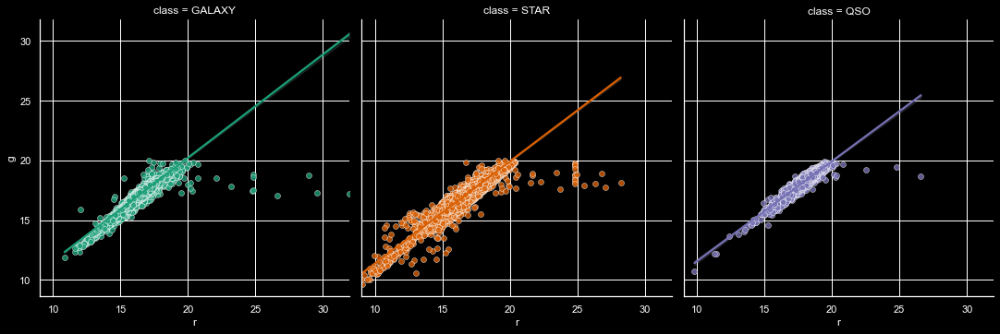

In [25]:
%%time
sns.lmplot(x = 'plate', y='mjd', data = df, hue='class', col = 'class', palette='Set1', scatter_kws= {'edgecolor':'white', 'alpha':0.8, 'linewidths': 0.5})
sns.lmplot(x = 'i', y='z', data = df, hue='class', col = 'class', palette='magma', scatter_kws= {'edgecolor':'white', 'alpha':0.8, 'linewidths': 0.5})
sns.lmplot(x = 'r', y='g', data = df, hue='class', col = 'class', palette='Dark2', scatter_kws= {'edgecolor':'white', 'alpha':0.8, 'linewidths': 0.5})

## 5.3 Correlation between different variables

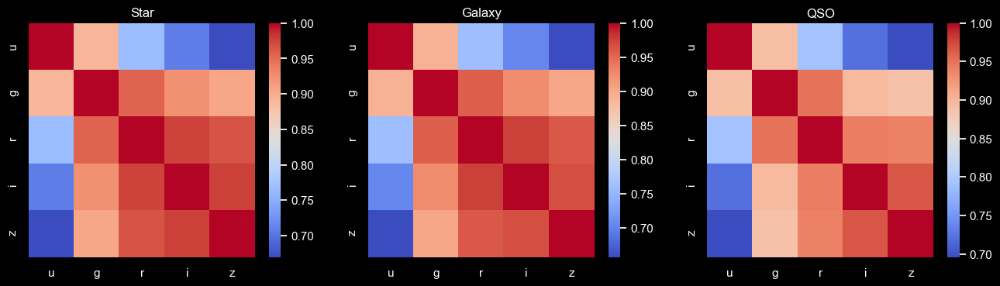

In [26]:
fig, axes = plt.subplots(nrows=1, ncols=3,figsize=(16, 4))
fig.set_dpi(100)
ax = sns.heatmap(df[df['class']=='STAR'][['u', 'g', 'r', 'i', 'z']].corr(), ax = axes[0], cmap='coolwarm')
ax.set_title('Star')
ax = sns.heatmap(df[df['class']=='GALAXY'][['u', 'g', 'r', 'i', 'z']].corr(), ax = axes[1], cmap='coolwarm')
ax.set_title('Galaxy')
ax = sns.heatmap(df[df['class']=='QSO'][['u', 'g', 'r', 'i', 'z']].corr(), ax = axes[2], cmap='coolwarm')
ax = ax.set_title('QSO')

## 5.4 Subplot

<AxesSubplot:>

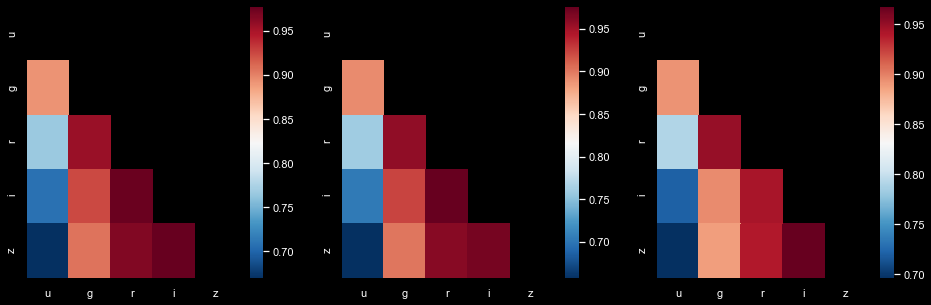

In [27]:
f, axes = plt.subplots(1, 3, figsize=(16, 5))

star_corr = df.loc[df['class']=='STAR', ['u','g','r','i','z']].corr()
galaxy_corr =df.loc[df['class']=='GALAXY', ['u','g','r','i','z']].corr()
qso_corr = df.loc[df['class']=='QSO', ['u','g','r','i','z']].corr()

msk = np.zeros_like(star_corr)
msk[np.triu_indices_from(msk)] = True

sns.heatmap(star_corr, cmap='RdBu_r', mask=msk, ax=axes[0])
sns.heatmap(galaxy_corr, cmap='RdBu_r', mask=msk, ax=axes[1])
sns.heatmap(qso_corr, cmap='RdBu_r', mask=msk, ax=axes[2])

## 5.4 3-D Scatterplot

In [4]:
lbl = LabelEncoder()
cls_enc = lbl.fit_transform(df['class'])

g = go.Scatter3d(
    x=df['ra'], y=df['dec'], z=df['redshift'],
    mode='markers',
    marker=dict(
        color=cls_enc,
        opacity=0.5,
    )
)

g_data = [g]

layout = go.Layout(margin=dict(
    l=0, r=0, b=0, t=0
))

figure = go.Figure(data=g_data, layout=layout)

iplot(figure, filename='3d-repr-redshift')

## 5.5 Subplot

<AxesSubplot:xlabel='redshift', ylabel='Density'>

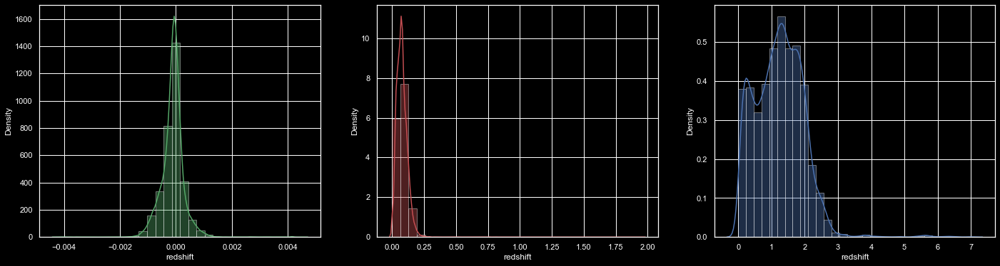

In [29]:
fig, (ax1, ax2, ax3) = plt.subplots(ncols = 3, figsize = (24, 6))
sns.distplot(df[df['class'] == 'STAR'].redshift, ax = ax1, bins = 30, color = 'g')
sns.distplot(df[df['class'] == 'GALAXY'].redshift, ax = ax2, bins = 30, color = 'r')
sns.distplot(df[df['class'] == 'QSO'].redshift, ax = ax3, bins = 30, color = 'b')

In [41]:
def distribution(df, axes, feature, row):
    '''Plot the distribution of a space object w.r.t. a given feature.'''
    labels = np.unique(df['class'])
    colors = ['skyblue', 'gold', 'red']
    for i in range(len(labels)):
        label = labels[i]
        ax = sns.distplot(df.loc[df['class']==label, feature], 
                          kde=False, bins=30, ax=axes[row, i], color=colors[i])
        ax.set_title(label)
        if (i == 0):
            ax.set(ylabel='Count')
           

## Removing Outliers

In [38]:
#Sometimes due to outliers, we can't do good analysis of our data therefore, we decided to remove them as our current dataset contains alot of outliers

def rem_outliers():
    s1 = df.shape

    for i in df.select_dtypes(include = 'number').columns:
        qt1 = df[i].quantile(0.25)
        qt3 = df[i].quantile(0.75)
        iqr =  qt3 - qt1
        lower = qt1-(1.5*iqr)
        upper = qt3+(1.5*iqr)
        min_in = df[df[i]<lower].index
        max_in = df[df[i]>upper].index
        df.drop(min_in, inplace = True)
        df.drop(max_in, inplace = True)
    
    s2 = df.shape
    outliers = s1[0] - s2[0]
    return outliers

In [39]:
print("Number of outliers deleted are : ", rem_outliers())

Number of outliers deleted are :  22790


In [40]:
df.shape

(77210, 11)

## 5.4 Pairplot

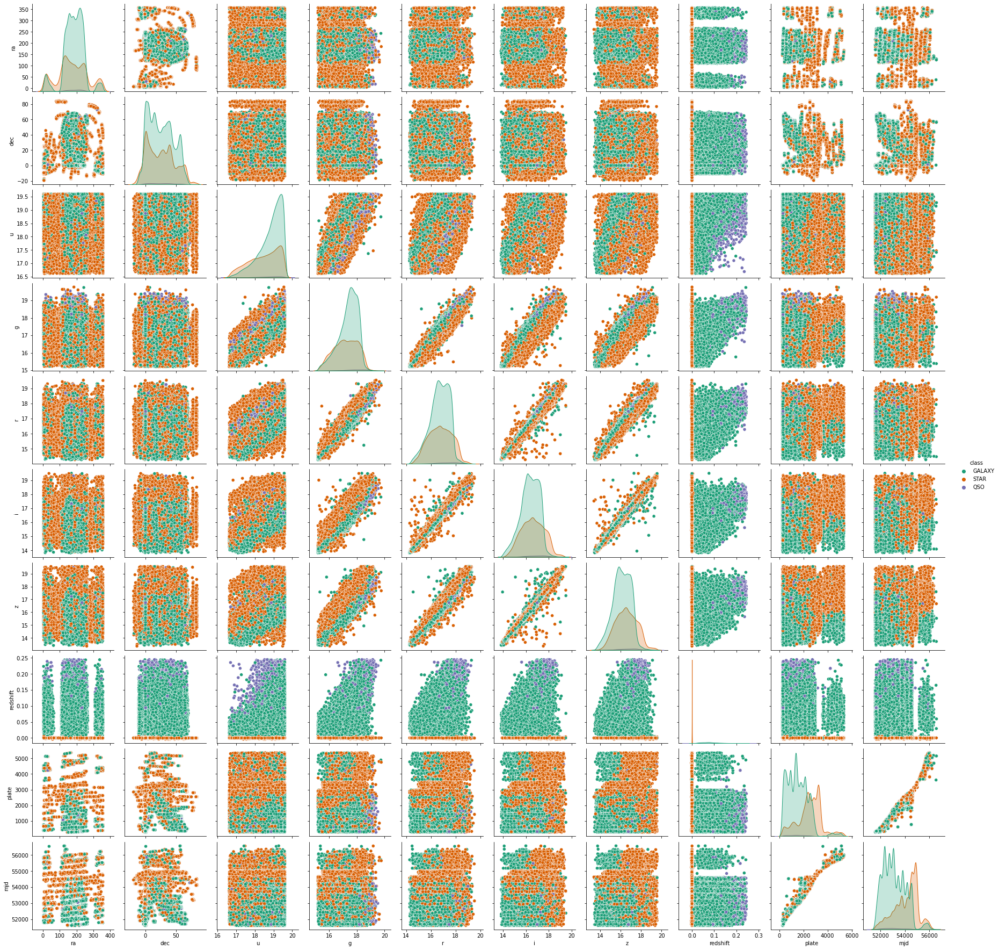

In [18]:
sns.pairplot(df,palette = 'Dark2',hue = 'class')

## 5.5 Correlation Matrix

,ra,dec,u,g,r,i,z,redshift,plate,mjd
ra,1.000000,0.054652,0.016463,0.019506,0.013206,0.006705,-0.000617,0.049057,0.003047,0.041765
dec,0.054652,1.000000,-0.020849,-0.023028,-0.019869,-0.019009,-0.014103,0.004714,0.025852,0.025079
u,0.016463,-0.020849,1.000000,0.859561,0.685888,0.595883,0.516801,0.397221,-0.068822,-0.070772
g,0.019506,-0.023028,0.859561,1.000000,0.949588,0.895153,0.843922,0.308837,-0.022102,-0.027656
r,0.013206,-0.019869,0.685888,0.949588,1.000000,0.985407,0.963497,0.129829,0.031882,0.024378
i,0.006705,-0.019009,0.595883,0.895153,0.985407,1.000000,0.990258,0.014931,0.078392,0.069568
z,-0.000617,-0.014103,0.516801,0.843922,0.963497,0.990258,1.000000,-0.061164,0.110117,0.100618
redshift,0.049057,0.004714,0.397221,0.308837,0.129829,0.014931,-0.061164,1.000000,-0.361682,-0.357039
plate,0.003047,0.025852,-0.068822,-0.022102,0.031882,0.078392,0.110117,-0.361682,1.000000,0.967004
mjd,0.041765,0.025079,-0.070772,-0.027656,0.024378,0.069568,0.100618,-0.357039,0.967004,1.000000


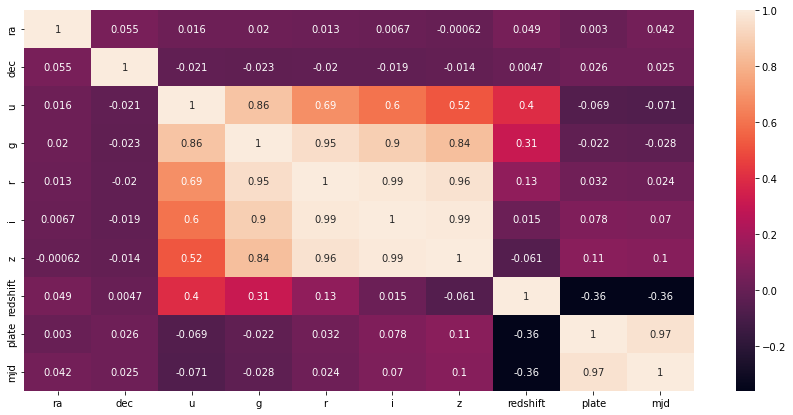

In [16]:
plt.figure(figsize=(15,7))
sns.heatmap(df.corr(), annot=True)
df.corr()

## 5.6 Pandas Profiling

In [34]:
import pandas_profiling
profile = pandas_profiling.ProfileReport(df, title='Dataset Report')
profile.to_file(output_file='SDSS_with_pandas_profiling.html')

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

## 5.7 Ra Vs Dec : Equatorial Coordinates Plot

Text(0.5, 1.0, 'Equatorial coordinates')

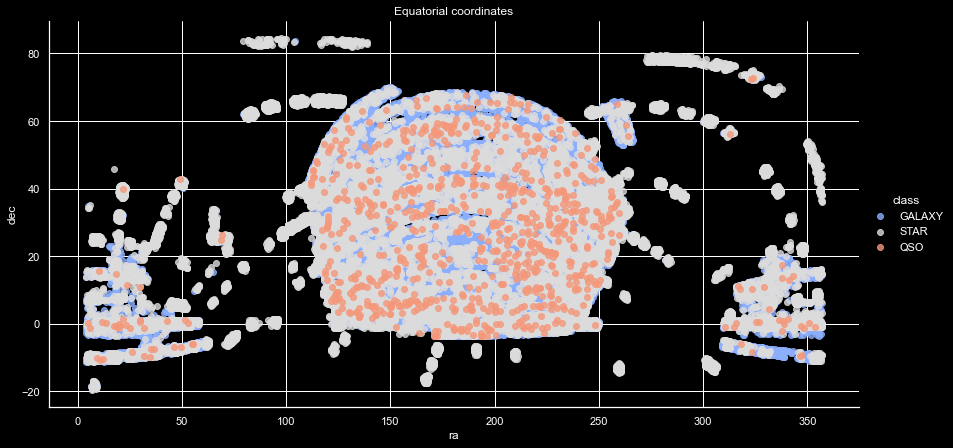

In [38]:
sns.lmplot(x='ra', y='dec', data= df, hue='class', fit_reg=False, palette='coolwarm', size=6, aspect=2)
plt.title('Equatorial coordinates')

## 6. ML Algorithms

## Feature Engineering

Encoding class labels
For some cases, we cannot simply provide categorical values (just strings). Instead, we can convert them to numerical values. For example, since we have 3 classes, we able to assign to each class some values, so that:

0 is for GALAXY

1 is for QSO

2 is for STAR

In [41]:
from sklearn.model_selection import train_test_split, cross_val_predict, cross_val_score
from sklearn.preprocessing import LabelEncoder, MinMaxScaler
from sklearn.metrics import confusion_matrix, precision_score
import time

In [42]:
# Some algorithms don't support categorical classes so we'll have to replace them with numbers
d=pd.DataFrame(df)


class_num=pd.DataFrame(LabelEncoder().fit_transform(d['class']), columns=['class'])
d.drop(['class'], axis=1, inplace=True)
names=list(d)

In [43]:
# Data are normalized for better conditioning of the problem

scaler = MinMaxScaler()
d=pd.DataFrame(scaler.fit_transform(d), columns=names)


d=pd.concat([d, class_num], axis=1)

d.head(3)

,ra,dec,u,g,r,i,z,redshift,plate,mjd,class
0,0.583531,0.225219,0.993319,0.548551,0.470302,0.443875,0.420928,0.318379,0.115777,0.147112,0
1,0.377967,0.609451,0.899177,0.644423,0.653889,0.645508,0.656862,0.392162,0.111068,0.141678,0
2,0.028469,0.333105,0.893860,0.511548,0.466311,0.442256,0.432053,0.333003,0.030416,0.042866,0


In [44]:
# A cross validation will be performed to ensure the reliability of the results.

# In addition, an isolated training will serve to measure the times and extract a matrix of confusion than will give us a general idea.

x=d.drop('class',axis=1);
y=d['class']

x_train, x_test, y_train, y_test = train_test_split(d.drop('class',axis=1), d['class'], test_size=0.4)

In [45]:
x_train

,ra,dec,u,g,r,i,z,redshift,plate,mjd
56088,0.404567,0.330435,0.476555,0.430090,0.486289,0.509419,0.529828,0.017475,0.991758,0.883679
28766,0.585298,0.221945,0.525255,0.293249,0.269646,0.257989,0.255557,0.414510,0.886578,0.818877
71119,0.395523,0.256426,0.729201,0.460285,0.462354,0.464368,0.486219,0.017417,0.566130,0.643188
465,0.518891,0.636352,0.581297,0.293840,0.275451,0.269930,0.271334,0.176602,0.232928,0.297042
58210,0.367805,0.213347,0.405096,0.357758,0.431539,0.456988,0.485253,0.021762,0.514521,0.587845
...,...,...,...,...,...,...,...,...,...,...
66836,0.363686,0.580206,0.451637,0.345699,0.469477,0.529210,0.565598,0.015816,0.110479,0.138458
18879,0.059394,0.405294,0.716529,0.351666,0.329223,0.341792,0.362222,0.016921,0.348901,0.345945
35179,0.370538,0.645341,0.395773,0.247207,0.212250,0.199978,0.215494,0.237992,0.097724,0.126786
35396,0.366339,0.228464,0.715389,0.461006,0.474499,0.488084,0.504550,0.016702,0.514521,0.587845


In [46]:
y_test

21789    0
51252    0
45396    0
72987    0
24652    0
        ..
72728    2
26598    0
20765    2
10176    0
72504    2
Name: class, Length: 30884, dtype: int64

## 6.1 LOGISTIC REGRESSION

The first iteration of the Logistic Regression gives an accuracy of the 98.04 %
[0=Galaxy 1=Quasar 2=Star]
CPU times: user 3.19 s, sys: 334 ms, total: 3.52 s
Wall time: 2 s


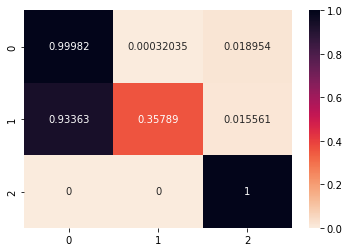

In [48]:
%%time
from sklearn import linear_model, datasets


lr = linear_model.LogisticRegression() 

training_start = time.perf_counter()
lr.fit(x_train, y_train)#Training
training_end = time.perf_counter()

predict_start = time.perf_counter()
preds = lr.predict(x_test)#Prediction
predict_end = time.perf_counter()
acc_lreg = (preds == y_test).sum().astype(float) / len(preds)*100

print("The first iteration of the Logistic Regression gives an accuracy of the %3.2f %%" % (acc_lreg))

from numpy import linalg as LA
mc=confusion_matrix(y_test, preds)
mc_norm = mc / np.linalg.norm(mc, axis=1, keepdims=True)
sns.heatmap(pd.DataFrame(mc_norm), cmap=sns.cm.rocket_r, annot=True, fmt='.5g',);

print("[0=Galaxy 1=Quasar 2=Star]")

In [49]:
%%time
lr_train_t=training_end-training_start;
lr_predict_t=predict_end-predict_start;

scores = cross_val_score(lr, x, y, cv=10, scoring = "accuracy")
score_lr=scores.mean()
print("The 10 cross validations of Logistic Regression have had an average success rate of  %3.2f %%" %(score_lr*100))
std_lr=scores.std()
print("..and a standard deviation of %8.5f" %(std_lr))

The 10 cross validations of Logistic Regression have had an average success rate of  98.16 %
..and a standar deviation of  0.00129
CPU times: user 43.5 s, sys: 4.72 s, total: 48.3 s
Wall time: 27.1 s


## 6.2 KNN Neighbors

The first iteration of the K-Nearest Neighbours gives an accuracy of the 97.57 %
[0=Galaxy 1=Quasar 2=Star]


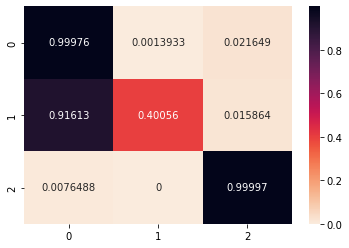

In [50]:
from sklearn.neighbors import KNeighborsClassifier

knn = KNeighborsClassifier()

training_start = time.perf_counter()
knn.fit(x_train, y_train)
training_end = time.perf_counter()

predict_start = time.perf_counter()
preds = knn.predict(x_test)
predict_end = time.perf_counter()
acc_knn = (preds == y_test).sum().astype(float) / len(preds)*100

print("The first iteration of the K-Nearest Neighbours gives an accuracy of the %3.2f %%" % (acc_knn))



mc=confusion_matrix(y_test, preds)
mc_norm = mc / np.linalg.norm(mc, axis=1, keepdims=True)
sns.heatmap(pd.DataFrame(mc_norm), cmap=sns.cm.rocket_r, annot=True, fmt='.5g')


print("[0=Galaxy 1=Quasar 2=Star]")

In [51]:
%%time
knn_train_t=training_end-training_start;
knn_predict_t=predict_end-predict_start;

scores = cross_val_score(knn, x, y, cv=10, scoring = "accuracy")
score_knn=scores.mean()
print("The 10 cross validations of K- Nearest Neighbours have had an average success rate of %3.2f %%" %(score_knn*100))
std_knn=scores.std()
print("..and a standard deviation of %8.5f" %(std_knn))

The 10 cross validations of K- Nearest Neighbours have had an average success rate of 97.63 %
..and a standard deviation of  0.00095
CPU times: user 8.79 s, sys: 132 ms, total: 8.92 s
Wall time: 9.52 s


## 6.3 NAIVE BAYES

The first iteration of the naive Bayes gives an accuracy of the 97.37 %


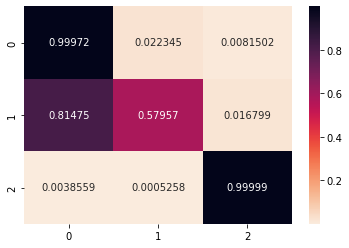

In [52]:
from sklearn.naive_bayes import GaussianNB

gnb = GaussianNB()

training_start = time.perf_counter()
gnb.fit(x_train, y_train)
training_end = time.perf_counter()

predict_start=time.perf_counter()
preds = gnb.predict(x_test)
predict_end = time.perf_counter()
acc_gnb = (preds == y_test).sum().astype(float) / len(preds)*100


print("The first iteration of the naive Bayes gives an accuracy of the %3.2f %%" % (acc_gnb))


mc=confusion_matrix(y_test, preds)
mc_norm = mc / np.linalg.norm(mc, axis=1, keepdims=True)
sns.heatmap(pd.DataFrame(mc_norm), cmap=sns.cm.rocket_r, annot=True, fmt='.5g');

In [54]:
%%time
gnb_train_t=training_end-training_start;
gnb_predict_t=predict_end-predict_start;

scores = cross_val_score(gnb, x, y, cv=10, scoring = "accuracy")
score_gnb=scores.mean()
print("The 10 cross validations of naive Bayes have had an average success rate of %3.2f %%" %(score_gnb*100))
std_gnb=scores.std()
print("..and a standard deviation of %8.6f" %(std_gnb))

The 10 cross validations of naive Bayes have had an average success rate of 97.43 %
..and a standard deviation of 0.001663
CPU times: user 338 ms, sys: 90.4 ms, total: 428 ms
Wall time: 446 ms


## 6.4 RANDOM FOREST

The first iteration of the Random Forest gives an accuracy of the 98.97 %


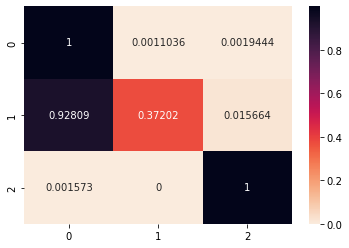

In [55]:
from sklearn.ensemble import RandomForestClassifier

rfc = RandomForestClassifier(n_estimators=10)

training_start = time.perf_counter()
rfc.fit(x_train, y_train)
training_end = time.perf_counter()

predict_start=time.perf_counter()
preds = rfc.predict(x_test)
predict_end = time.perf_counter()

acc_rfc = (preds == y_test).sum().astype(float) / len(preds)*100


print("The first iteration of the Random Forest gives an accuracy of the %3.2f %%" % (acc_rfc))


mc=confusion_matrix(y_test, preds)
mc_norm = mc / np.linalg.norm(mc, axis=1, keepdims=True)
sns.heatmap(pd.DataFrame(mc_norm), cmap=sns.cm.rocket_r, annot=True, fmt='.5g');

In [56]:
%%time
rfc_train_t=training_end-training_start;
rfc_predict_t=predict_end-predict_start;

scores = cross_val_score(rfc, x, y, cv=10, scoring = "accuracy")
score_rfc=scores.mean()
print("The 10 cross validations of Random Forest have had an average success rate of %3.2f" %(score_rfc*100))
std_rfc=scores.std()
print("..and a standard deviation of %8.6f" %(std_rfc))

The 10 cross validations of Random Forest have had an average success rate of 99.09
..and a standard deviation of 0.000956
CPU times: user 28.1 s, sys: 482 ms, total: 28.6 s
Wall time: 33.3 s


## 6.5 SUPPORT VECTOR MACHINES

The first iteration of the SVM gives an accuracy of the 97.42 %


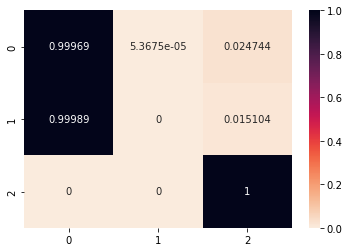

In [57]:
from sklearn.svm import SVC

svm = SVC(kernel='sigmoid', gamma='auto')

training_start = time.perf_counter()
svm.fit(x_train, y_train)
training_end = time.perf_counter()

predict_start = time.perf_counter()
preds = svm.predict(x_test)
predict_end = time.perf_counter()

acc_svm = (preds == y_test).sum().astype(float) / len(preds)*100


print("The first iteration of the SVM gives an accuracy of the %3.2f %%" % (acc_svm))


mc=confusion_matrix(y_test, preds)
mc_norm = mc / np.linalg.norm(mc, axis=1, keepdims=True)
sns.heatmap(pd.DataFrame(mc_norm), cmap=sns.cm.rocket_r, annot=True, fmt='.5g');

In [58]:
%%time
svm_train_t=training_end-training_start;
svm_predict_t=predict_end-predict_start;

scores = cross_val_score(svm, x, y, cv=10, scoring = "accuracy")
score_svm=scores.mean()
print("The 10 cross validations of SVM have had an average success rate of %3.2f %%" %(score_svm*100))
std_svm=scores.std()
print("..and a standard deviation of %8.6f" %(std_svm))

The 10 cross validations of SVM have had an average success rate of 97.53 %
..and a standard deviation of 0.001047
CPU times: user 14min 41s, sys: 14.5 s, total: 14min 55s
Wall time: 15min 48s


## 6.6 NEURAL NETWORKS
### Multi-layer Perceptron classifier ( MLPC )

The first iteration of the Neural Networks gives an accuracy of the 98.33 %
CPU times: user 5.41 s, sys: 628 ms, total: 6.03 s
Wall time: 3.4 s


<AxesSubplot:>

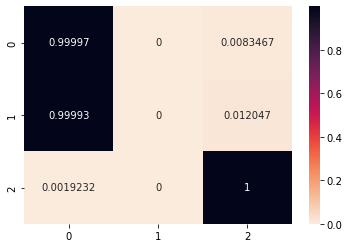

In [88]:
%%time
from sklearn.neural_network import MLPClassifier

nnc = MLPClassifier(solver='lbfgs', alpha=1e-5, hidden_layer_sizes=(4, 3), random_state=1)

training_start = time.perf_counter()
nnc.fit(x_train, y_train)                         
training_end = time.perf_counter()

predict_start = time.perf_counter()
preds=nnc.predict(x_test)
predict_end=time.perf_counter()

acc_nnc = (preds == y_test).sum().astype(float) / len(preds)*100
print("The first iteration of the Neural Networks gives an accuracy of the %3.2f %%" % (acc_nnc))
mc=confusion_matrix(y_test, preds)
mc_norm = mc / np.linalg.norm(mc, axis=1, keepdims=True)
sns.heatmap(pd.DataFrame(mc_norm), cmap=sns.cm.rocket_r, annot=True, fmt='.5g');

In [89]:
%%time
nnc_train_t=training_end-training_start;
nnc_predict_t=predict_end-predict_start;

scores = cross_val_score(nnc, x, y, cv=10, scoring = "accuracy")
score_nnc=scores.mean()
print("The 10 cross validations of Neural Networks have had an average success rate of %3.2f %%" %(score_nnc*100))
std_nnc=scores.std()
print("..and a standard deviation of %8.6f" %(std_nnc))

The 10 cross validations of Neural Networks have had an average success rate of 98.40 %
..and a standard deviation of 0.000522
CPU times: user 1min 52s, sys: 11.5 s, total: 2min 3s
Wall time: 1min 7s


## 6.7 DECISION TREE

The first iteration of the Decision tree gives an accuracy of the 98.73 %


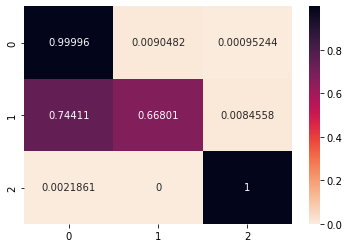

In [90]:
from sklearn.tree import DecisionTreeClassifier

nnc = DecisionTreeClassifier(criterion='entropy', random_state=0)
 
training_start = time.perf_counter()
nnc.fit(x_train, y_train)                         
training_end = time.perf_counter()

predict_start = time.perf_counter()
preds=nnc.predict(x_test)
predict_end=time.perf_counter()

acc_nnc = (preds == y_test).sum().astype(float) / len(preds)*100
print("The first iteration of the Decision tree gives an accuracy of the %3.2f %%" % (acc_nnc))
mc=confusion_matrix(y_test, preds)
mc_norm = mc / np.linalg.norm(mc, axis=1, keepdims=True)
sns.heatmap(pd.DataFrame(mc_norm), cmap=sns.cm.rocket_r, annot=True, fmt='.5g');



In [91]:
%%time
nnc_train_t=training_end-training_start;
nnc_predict_t=predict_end-predict_start;

scores = cross_val_score(nnc, x, y, cv=10, scoring = "accuracy")
score_nnd=scores.mean()
print("The 10 cross validations of Decision tree have had an average success rate of %3.2f %%" %(score_nnd*100))
std_nnc=scores.std()
print("..and a standard deviation of %8.6f" %(std_nnc))

The 10 cross validations of Decision tree have had an average success rate of 98.79 %
..and a standard deviation of 0.000849
CPU times: user 12.5 s, sys: 150 ms, total: 12.7 s
Wall time: 13.1 s


## COMPARISON OF MODEL ACCURACIES

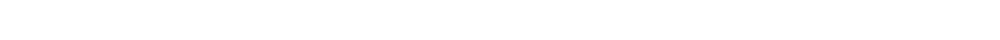

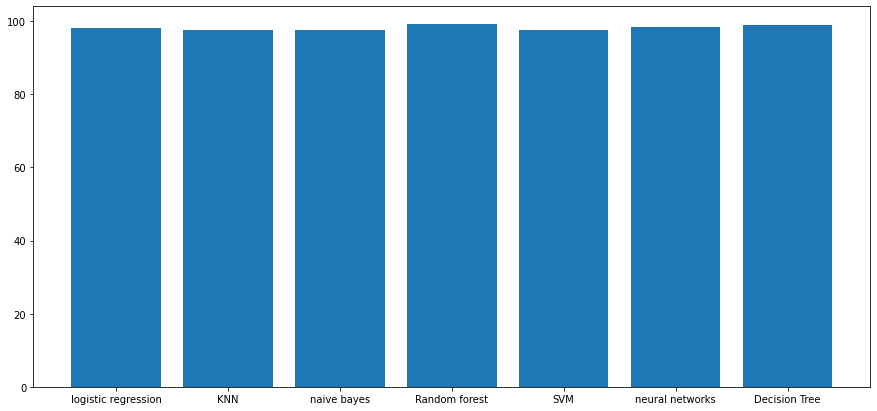

In [96]:
data = {'logistic regression':score_lr,'KNN':score_knn,'naive bayes':score_gnb,
        'Random forest':score_rfc,'SVM':score_svm,'neural networks':score_nnc,'Decision Tree':score_nnd}
val1 = list(data.keys())
val2 = list(data.values())
per = [element * 100 for element in val2]

for index, value in enumerate(per):
    plt.text(value, index,
             str(value))

fig = plt.figure(figsize = (15,7))
plt.bar(val1,per)


plt.show()

In [93]:
per

[98.16085999222899,
 97.63113586323013,
 97.43297500323791,
 99.08820101023184,
 97.53011267970471,
 98.40046626084705,
 98.79160730475327]